

## 1. Importing Necessary Libraries

In [93]:
import preprocessor as preprocessor
import svm as svm
import ytest as ytest
%matplotlib inline
import pandas as pd
import numpy as np
import pandas_profiling as pp
import matplotlib.pyplot as plt
from sklearn.ensemble import ExtraTreesClassifier
import seaborn as sns
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from lightgbm import LGBMClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split
import sklearn.metrics as metrics

## 2. Importing Dataset

In [94]:
data = pd.read_csv(r'dataset_of_diabetes.csv')
print("Data Shape - ", data.shape)
data.head(5)
# show the data of how many rows and columns

Data Shape -  (1000, 14)


,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
1,735,34221,M,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,N
2,420,47975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
3,680,87656,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
4,504,34223,M,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,N


## 3. Understanding the Data

In [95]:
# discription of the current data set
data.describe()

,ID,No_Pation,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI
count,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,340.500000,2.705514e+05,53.528000,5.124743,68.943000,8.281160,4.862820,2.349610,1.204750,2.609790,1.854700,29.578020
std,240.397673,3.380758e+06,8.799241,2.935165,59.984747,2.534003,1.301738,1.401176,0.660414,1.115102,3.663599,4.962388
min,1.000000,1.230000e+02,20.000000,0.500000,6.000000,0.900000,0.000000,0.300000,0.200000,0.300000,0.100000,19.000000
25%,125.750000,2.406375e+04,51.000000,3.700000,48.000000,6.500000,4.000000,1.500000,0.900000,1.800000,0.700000,26.000000
50%,300.500000,3.439550e+04,55.000000,4.600000,60.000000,8.000000,4.800000,2.000000,1.100000,2.500000,0.900000,30.000000
75%,550.250000,4.538425e+04,59.000000,5.700000,73.000000,10.200000,5.600000,2.900000,1.300000,3.300000,1.500000,33.000000
max,800.000000,7.543566e+07,79.000000,38.900000,800.000000,16.000000,10.300000,13.800000,9.900000,9.900000,35.000000,47.750000


In [96]:
data.describe(include = np.object).transpose()

C:\Users\alici\AppData\Local\Temp\ipykernel_7912\466961875.py:1: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  data.describe(include = np.object).transpose()


,count,unique,top,freq
Gender,1000,3,M,565
CLASS,1000,5,Y,840


In [97]:
data['Gender'].value_counts(normalize=True)

M    0.565
F    0.434
f    0.001
Name: Gender, dtype: float64

In [98]:
data.Gender.unique()

array(['F', 'M', 'f'], dtype=object)

In [99]:
data.tail()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
995,200,454317,M,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,Y
996,671,876534,M,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,Y
997,669,87654,M,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,Y
998,99,24004,M,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,Y
999,248,24054,M,54,5.0,67,6.9,3.8,1.7,1.1,3.0,0.7,33.0,Y


In [100]:
# check out if the data has all the data
data.isnull().values.any()

False

In [101]:
# to know the Dtype of the features
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         1000 non-null   int64  
 1   No_Pation  1000 non-null   int64  
 2   Gender     1000 non-null   object 
 3   AGE        1000 non-null   int64  
 4   Urea       1000 non-null   float64
 5   Cr         1000 non-null   int64  
 6   HbA1c      1000 non-null   float64
 7   Chol       1000 non-null   float64
 8   TG         1000 non-null   float64
 9   HDL        1000 non-null   float64
 10  LDL        1000 non-null   float64
 11  VLDL       1000 non-null   float64
 12  BMI        1000 non-null   float64
 13  CLASS      1000 non-null   object 
dtypes: float64(8), int64(4), object(2)
memory usage: 109.5+ KB


In [102]:
data['CLASS'].value_counts(normalize=True)

Y     0.840
N     0.102
P     0.053
Y     0.004
N     0.001
Name: CLASS, dtype: float64

In [103]:
data['Gender'] = data.apply(lambda row: 0 if row['Gender'] == 'M' else 1, axis=1)

In [104]:
data['Gender'].value_counts(normalize=True)


0    0.565
1    0.435
Name: Gender, dtype: float64

In [105]:
data.CLASS.unique()

array(['N', 'N ', 'P', 'Y', 'Y '], dtype=object)

In [106]:
data['Gender'].value_counts(normalize=True)


0    0.565
1    0.435
Name: Gender, dtype: float64

In [107]:
data.CLASS.unique()

array(['N', 'N ', 'P', 'Y', 'Y '], dtype=object)

In [108]:
# fix space in the data in CLASS column
def fix_class(row):
    if row['CLASS'] == 'N':
        return 0
    elif row['CLASS'] == 'P':
        return 1
    elif row['CLASS'] == 'Y':
        return 2
    elif row['CLASS'] == 'N ':
        return 0
    elif row['CLASS'] == 'Y ':
        return 2

In [109]:
data['CLASS'] = data.apply(lambda row: fix_class(row), axis=1)
data.CLASS.unique()

array([0, 1, 2], dtype=int64)

In [110]:
data.head()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
1,735,34221,0,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,0
2,420,47975,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
3,680,87656,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
4,504,34223,0,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,0


In [111]:
data.tail()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
995,200,454317,0,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,2
996,671,876534,0,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,2
997,669,87654,0,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,2
998,99,24004,0,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,2
999,248,24054,0,54,5.0,67,6.9,3.8,1.7,1.1,3.0,0.7,33.0,2


# 4. Data Profiling Report

In [112]:
pp.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 5. EDA(Exploratory Data Analysis)

 ####        Drop out unnecessary column

In [113]:
data_new = data.drop(['ID', 'No_Pation'], axis=1)

In [114]:
df = pd.get_dummies(data_new, columns=['CLASS'])
df.head()

,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS_0,CLASS_1,CLASS_2
0,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,1,0,0
1,0,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,1,0,0
2,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,1,0,0
3,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,1,0,0
4,0,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,1,0,0


### 5.1 Eliminate duplicates

In [115]:
# Eliminate duplicates
print('There are' , df.duplicated().sum() , 'duplicates')
df.loc[data_new.duplicated(keep=False),:]
df.drop_duplicates(keep='first',inplace=True)
print('There is now' , df.shape[0] , 'rows')
print('There is now' , df.shape[1] , 'columns')

There are 174 duplicates
There is now 826 rows
There is now 14 columns


### 5.2 Let's check if there are any null variables in the data_new dataset

In [116]:
data_new.isnull().sum()

Gender    0
AGE       0
Urea      0
Cr        0
HbA1c     0
Chol      0
TG        0
HDL       0
LDL       0
VLDL      0
BMI       0
CLASS     0
dtype: int64

# 6. Feature Engineering

### 6.1 Pearson corelation

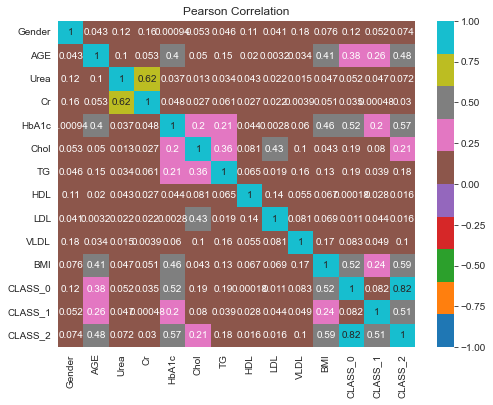

HDL        0.000184
LDL        0.010858
Cr         0.035244
Urea       0.052351
CLASS_1    0.081807
VLDL       0.083117
Gender     0.120338
TG         0.185089
Chol       0.188953
AGE        0.379792
BMI        0.516275
HbA1c      0.522585
CLASS_2    0.816825
CLASS_0    1.000000
Name: CLASS_0, dtype: float64
Cr         0.000477
HDL        0.028001
TG         0.039025
LDL        0.043848
Urea       0.046913
VLDL       0.049219
Gender     0.052028
Chol       0.080384
CLASS_0    0.081807
HbA1c      0.200683
BMI        0.241542
AGE        0.258576
CLASS_2    0.508129
CLASS_1    1.000000
Name: CLASS_1, dtype: float64
LDL        0.015997
HDL        0.016367
Cr         0.030181
Urea       0.072395
Gender     0.073878
VLDL       0.100317
TG         0.182539
Chol       0.209817
AGE        0.477878
CLASS_1    0.508129
HbA1c      0.567766
BMI        0.585964
CLASS_0    0.816825
CLASS_2    1.000000
Name: CLASS_2, dtype: float64


In [117]:
corr = df.corr(method='pearson').abs()

corr.describe()
corr.head()

fig = plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap='tab10', vmin=-1, vmax=+1)
plt.title('Pearson Correlation')
plt.show()

print (df.corr()['CLASS_0'].abs().sort_values())
print (df.corr()['CLASS_1'].abs().sort_values())
print (df.corr()['CLASS_2'].abs().sort_values())

### 6.2 Univariate Selection using SelectKBest

In [118]:
X = df.iloc[:,0:20]  #independent columns
y = df.iloc[:,-1]    #target column

#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=10)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

#concat two dataframes for better visualization
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(13,'Score'))  #print 10 best features

      Specs       Score
11  CLASS_0  487.058824
1       AGE  273.280702
10      BMI  240.069022
4     HbA1c  216.346463
12  CLASS_1  202.941176
13  CLASS_2  136.000000
9      VLDL   57.900939
3        Cr   38.617000
6        TG   24.316273
5      Chol   13.092608
2      Urea    7.900296
0    Gender    2.527052
8       LDL    0.104614


### 6.3 Feature Importance

[1.36480203e-03 1.28217725e-02 8.03268892e-04 4.63579579e-04
 4.41034165e-02 4.33869778e-03 3.51392507e-03 8.33688564e-04
 7.25333049e-04 1.17558183e-03 4.22775987e-02 3.05568327e-01
 1.11631233e-01 4.70378776e-01]


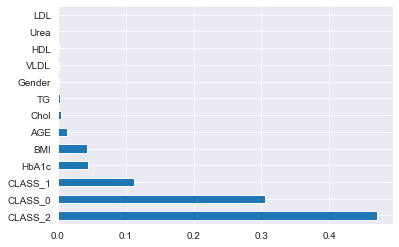

In [119]:
X = df.iloc[:,0:20]  #independent columns
y = df.iloc[:,-1]    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(13).plot(kind='barh')
plt.show()

### 6.4 Correlation Matrix with Heatmap

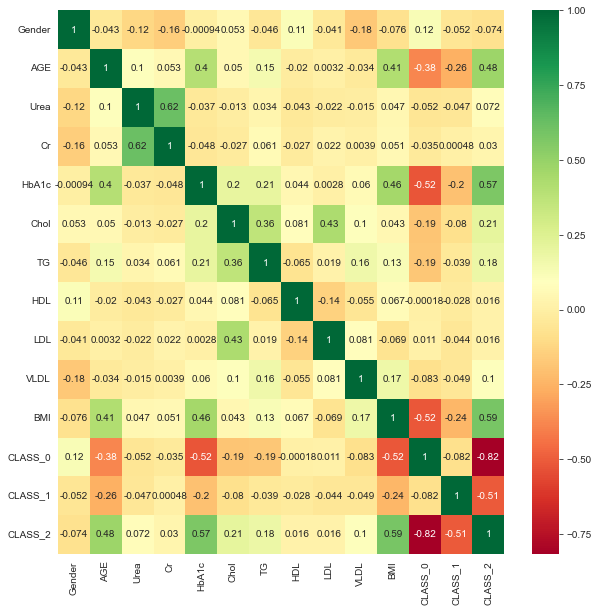

In [120]:
X = df.iloc[:,0:20]  #independent columns
y = df.iloc[:,-1]    #target column

#get correlations of each features in dataset
corrmat = df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(10,10))

#plot heat map
g=sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn")

# 7. Applying Different Models On Train & Test Data #only suggestion feel free to try out other models :)

### 7.1) Model 1 - GBM (Gradient Boosting)


#### 7.1.1) LightGBM

In [121]:
import  lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn import metrics

c:\languages\python\python390\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "


[30]	training's multi_logloss: 0.072109	valid_0's multi_logloss: 0.225409
[60]	training's multi_logloss: 0.0196772	valid_0's multi_logloss: 0.225203
[90]	training's multi_logloss: 0.00591342	valid_0's multi_logloss: 0.240197
Training accuracy 1.000000
Testing accuracy 0.928889
              precision    recall  f1-score   support

           0       0.87      0.81      0.84        91
           1       0.47      0.29      0.35        49
           2       0.95      0.98      0.97       760

    accuracy                           0.93       900
   macro avg       0.76      0.69      0.72       900
weighted avg       0.92      0.93      0.92       900



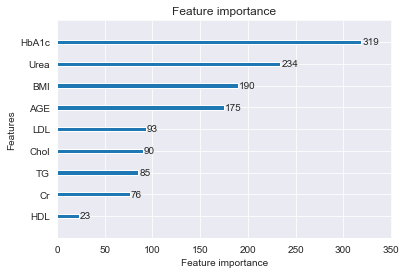

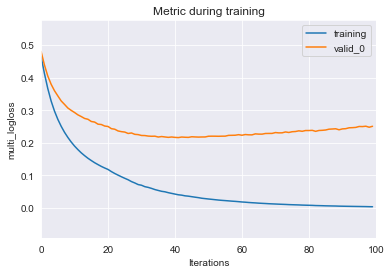

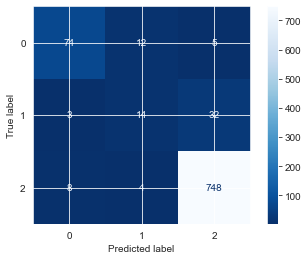

In [122]:
diabetes_gbm = data_new
diabetes_gbm.shape

# define input and output features to train model
x = diabetes_gbm.drop(['CLASS','Gender','VLDL'],axis=1)
y = diabetes_gbm.CLASS

# train and test splitting
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.90,random_state=42)
model = lgb.LGBMClassifier(learning_rate=0.08,max_depth=-3,random_state=42)
model.fit(x_train,y_train,eval_set=[(x_test,y_test),(x_train,y_train)],
          verbose=30,eval_metric='logloss')
print("Training accuracy {:4f}".format(model.score(x_train,y_train)))
print("Testing accuracy {:4f}".format(model.score(x_test,y_test)))

lgb.plot_importance(model)
lgb.plot_metric(model)
metrics.plot_confusion_matrix(model,x_test,y_test,cmap='Blues_r')
print(metrics.classification_report(y_test,model.predict(x_test)))

In [132]:
#another way of doing lightGBM
from sklearn.model_selection import train_test_split
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score

diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
LightGBMPipeline = make_pipeline(preprocessor,LGBMClassifier(learning_rate=0.08,max_depth=-3,random_state=42))

LightGBMPipeline.fit(X_train, y_train)

y_proba = LightGBMPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("LightGBM Accuracy: %.3f" % metrics.accuracy_score(y_test, y_pred))

the f1 score for Random Forest Classifier is : 0.9454645344936486
the precision score is : 0.9627303359697725
the recall score is : 0.9294016673163593
LightGBM Accuracy: 0.977


#### 7.1.2)  GBM

In [129]:
import sklearn
import pandas as pd
import numpy as np 

from sklearn.metrics import classification_report
from sklearn.model_selection import KFold
from sklearn.ensemble import GradientBoostingClassifier

#new version of the dataset. 
diabetes_sklearn = data_new
diabetes_sklearn.head()

x,y = diabetes_sklearn.drop('CLASS',axis=1),diabetes_sklearn.CLASS

kf = KFold(n_splits=5,random_state=42,shuffle=True)

for train_index,val_index in kf.split(x):
    x_train,x_val = x.iloc[train_index],x.iloc[val_index]
    y_train,y_val = y.iloc[train_index],y.iloc[val_index]
    
gradient_booster = GradientBoostingClassifier(learning_rate=0.1)
gradient_booster.get_params()

gradient_booster.fit(x_train,y_train)
print(classification_report(y_val,gradient_booster.predict(x_val)))

              precision    recall  f1-score   support

           0       0.92      0.96      0.94        25
           1       1.00      1.00      1.00         7
           2       0.99      0.99      0.99       168

    accuracy                           0.98       200
   macro avg       0.97      0.98      0.98       200
weighted avg       0.99      0.98      0.99       200



In [141]:
#another way of doing GBM
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score

diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
GBMPipline = make_pipeline(preprocessor,GradientBoostingClassifier(learning_rate=0.1))

GBMPipline.fit(X_train, y_train)

y_proba = GBMPipline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("GBM Accuracy %.3f" %metrics.accuracy_score(y_test, y_pred))

the f1 score for Random Forest Classifier is : 0.9624785511310333
the precision score is : 0.9743352149012526
the recall score is : 0.9515732819050354
GBM Accuracy 0.985


#### 7.1.3) XGBoost

In [139]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score

diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.80, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
XGBPipline = make_pipeline(preprocessor,XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bynode=1, colsample_bytree=1, gamma=0, learning_rate=0.1,
       max_delta_step=0, max_depth=3, min_child_weight=1, missing=1,
       n_estimators=100, n_jobs=1, nthread=None,
       objective='multi:softprob', random_state=0, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=None, seed=None, silent=None,
       subsample=1, verbosity=1))

XGBPipline.fit(X_train, y_train)

y_proba = XGBPipline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("XGBoost Accuracy %.3f" %metrics.accuracy_score(y_test, y_pred))

the f1 score for Random Forest Classifier is : 0.9503004066614902
the precision score is : 0.9842652398021322
the recall score is : 0.9203664962033162
XGBoost Accuracy 0.979


#### 7.1.4) CatBoost

In [142]:
from sklearn.model_selection import train_test_split

diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
CatPipeline = make_pipeline(preprocessor, CatBoostClassifier(iterations = 1000, loss_function='MultiClass',
                                                             bootstrap_type = "Bayesian",
                                                             eval_metric = 'MultiClass',
                                                             leaf_estimation_iterations = 100,
                                                             random_strength = 0.5,
                                                             depth = 7,
                                                             l2_leaf_reg = 5,
                                                             learning_rate=0.1,
                                                             bagging_temperature = 0.5,
                                                             allow_writing_files=False))
CatPipeline.fit(X_train, y_train)
y_proba = CatPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("CatBoost Accuracy %.3f" %metrics.accuracy_score(y_test, y_pred))

0:	learn: 0.7749422	total: 44.7ms	remaining: 44.6s
1:	learn: 0.4996760	total: 76.8ms	remaining: 38.3s
2:	learn: 0.3461693	total: 113ms	remaining: 37.4s
3:	learn: 0.2463637	total: 285ms	remaining: 1m 10s
4:	learn: 0.1774079	total: 301ms	remaining: 59.9s
5:	learn: 0.1353639	total: 404ms	remaining: 1m 6s
6:	learn: 0.1009567	total: 445ms	remaining: 1m 3s
7:	learn: 0.0766700	total: 485ms	remaining: 1m
8:	learn: 0.0590087	total: 522ms	remaining: 57.5s
9:	learn: 0.0465521	total: 560ms	remaining: 55.5s
10:	learn: 0.0377937	total: 602ms	remaining: 54.1s
11:	learn: 0.0322825	total: 645ms	remaining: 53.1s
12:	learn: 0.0270211	total: 676ms	remaining: 51.4s
13:	learn: 0.0234827	total: 709ms	remaining: 49.9s
14:	learn: 0.0202445	total: 878ms	remaining: 57.7s
15:	learn: 0.0180700	total: 920ms	remaining: 56.6s
16:	learn: 0.0158127	total: 950ms	remaining: 54.9s
17:	learn: 0.0134566	total: 981ms	remaining: 53.5s
18:	learn: 0.0119131	total: 1.02s	remaining: 52.6s
19:	learn: 0.0106588	total: 1.05s	remaini

#### 7.1.5) AdaBoost

In [144]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score


diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
AdaPipeline = make_pipeline(preprocessor,AdaBoostClassifier(n_estimators=200, learning_rate=1.4))

AdaPipeline.fit(X_train, y_train)
y_proba = AdaPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("Adaboost Accuracy %.3f" %metrics.accuracy_score(y_test, y_pred))

the f1 score for Random Forest Classifier is : 0.8827636691282305
the precision score is : 0.9193636975872183
the recall score is : 0.8519706202170657
Adaboost Accuracy 0.959


### 7.2) Model 2 - Logistic Regression


In [ ]:
# Importing basic packages
#
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
 
# Importing Sklearn module and classes
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import train_test_split

LG_diabetes = data_new
LG_diabetes.head()

x,y = LG_diabetes.drop('CLASS',axis=1),LG_diabetes.CLASS

X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=0.75, random_state=42, stratify=y)

sc = StandardScaler()
sc.fit(X_train)
X_train_std = sc.transform(X_train)
X_test_std = sc.transform(X_test)

# Create an instance of LogisticRegression classifier
lr = LogisticRegression(C=100.0, random_state=1, solver='lbfgs', multi_class='ovr')
 
# Fit the model
#
lr.fit(X_train_std, Y_train)

# Create the predictions
#
Y_predict = lr.predict(X_test_std)
 
# Use metrics.accuracy_score to measure the score
print("LogisticRegression Accuracy %.3f" %metrics.accuracy_score(Y_test, Y_predict))

### 7.3) Model 3 - Random Forest Classifier

a) Define model parameters to be tuned
b) Using GridSearch Cross Validation to find out the best parameters using L2 penalty
c) Displaying the best parameters
d) Refitting the model with the best parameters
e) Displaying model prediction and classification report
f) Saving the variables used in the model
g) Saving the best model
h) Model Evaluation
i) Making predictions for test data
j) Evaluating prediction accuracy for test data



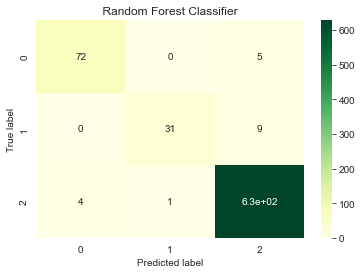

the f1 score for Random Forest Classifier is : 0.9291285403050109
the precision score is : 0.9647705224900256
the recall score is : 0.9007220136367056
Random Forest Accuracy 0.975


In [145]:
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier()
rf.fit(X_train,Y_train)

predictions = rf.predict(X_test)

sns.heatmap(confusion_matrix(Y_test, predictions), annot=True, cmap="YlGn")
plt.title(' Random Forest Classifier ')
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

print("the f1 score for Random Forest Classifier is :",(f1_score(Y_test, predictions, average="macro")))
print("the precision score is :",(precision_score(Y_test, predictions, average="macro")))
print("the recall score is :",(recall_score(Y_test, predictions, average="macro")))
print("Random Forest Accuracy %.3f" %metrics.accuracy_score(Y_test, predictions))


## 7.4 KNN

[[ 56   0  17]
 [ 19   0  30]
 [ 12   0 616]]
              precision    recall  f1-score   support

           0       0.64      0.77      0.70        73
           1       0.00      0.00      0.00        49
           2       0.93      0.98      0.95       628

    accuracy                           0.90       750
   macro avg       0.52      0.58      0.55       750
weighted avg       0.84      0.90      0.87       750



c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Text(0, 0.5, 'Mean Error')

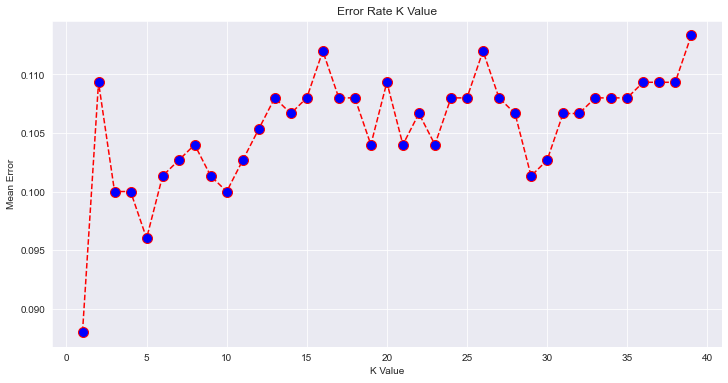

In [146]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

KNN_diabetes = data_new
KNN_diabetes.head()

X,y = KNN_diabetes.drop('CLASS',axis=1),KNN_diabetes.CLASS

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

from sklearn.neighbors import KNeighborsClassifier
classifier = KNeighborsClassifier(n_neighbors=8)
classifier.fit(X_train, y_train)

y_pred = classifier.predict(X_test)

from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

error = []

# Calculating error for K values between 1 and 40
for i in range(1, 40):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train, y_train)
    pred_i = knn.predict(X_test)
    error.append(np.mean(pred_i != y_test))
    
plt.figure(figsize=(12, 6))
plt.plot(range(1, 40), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate K Value')
plt.xlabel('K Value')
plt.ylabel('Mean Error')

## 7.5 Support Vector Machine

In [147]:
#multiclass problem for support vector machine https://scikit-learn.org/stable/modules/svm.html

from sklearn.metrics import roc_auc_score, accuracy_score
from sklearn.svm import SVC
from sklearn.svm import LinearSVC

diabetes_svm = data_new
diabetes_svm.head()

# define input and output features to train model
X = diabetes_svm.drop(['CLASS','Gender','VLDL'],axis=1)
y = diabetes_svm['CLASS']

# train and test splitting
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.90,random_state=42)

In [ ]:
#this model does not work yet .. still working on

#lin_clf = LinearSVC()
#lin_clf.fit(X, y)
#lin_clf_prediction = lin_clf.decision_function(X_test)
#print(lin_clf_prediction)

#print("the f1 score for Support Vector machine is :",(f1_score(y_test, lin_clf_prediction , average="macro")))
#print("the precision score is :",(precision_score(y_test, lin_clf_prediction , average="macro")))
#print("the recall score is :",(recall_score(y_test, lin_clf_prediction , average="macro")))
#print("Support Vector machine %.3f" %metrics.accuracy_score(y_test, lin_clf_prediction ))

In [148]:
#another way of doing support vector machine
SVM = SVC(random_state=0,probability=True,C=80.0,gamma=0.00002,kernel='rbf')
SVM.fit(X_train,y_train)
predictions3 = SVM.predict(X_test)
probabilities2 = SVM.predict_proba(X_test)

print("the f1 score for Support Vector machine is :",(f1_score(y_test, predictions3, average="macro")))
print("the precision score is :",(precision_score(y_test, predictions3, average="macro")))
print("the recall score is :",(recall_score(y_test, predictions3, average="macro")))
print("Support Vector machine acuracy %.3f" %metrics.accuracy_score(y_test, predictions3))

the f1 score for Support Vector machine is : 0.3436717047006576
the precision score is : 0.3485897566439263
the recall score is : 0.35138808559861195
Support Vector machine acuracy 0.817


c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## 7.6 linear regression

In [149]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score

# creating a dummy dataset
line_diabetes = data_new
line_diabetes.head()

diabetes_X,diabetes_y = line_diabetes.drop('CLASS',axis=1),line_diabetes.CLASS

# Split the data into training/testing sets
diabetes_X_train = diabetes_X[:-20]
diabetes_X_test = diabetes_X[-20:]

# Split the targets into training/testing sets
diabetes_y_train = diabetes_y[:-20]
diabetes_y_test = diabetes_y[-20:]

# Create linear regression object
regr = linear_model.LinearRegression()

# Train the model using the training sets
regr.fit(diabetes_X_train, diabetes_y_train)

# Make predictions using the testing set
diabetes_y_pred = regr.predict(diabetes_X_test)

# The coefficients
print("Coefficients: \n", regr.coef_)
# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(diabetes_y_test, diabetes_y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(diabetes_y_test, diabetes_y_pred))

# Plot outputs
#plt.scatter(diabetes_X_test, diabetes_y_test, color="black")
#plt.plot(diabetes_X_test, diabetes_y_pred, color="blue", linewidth=3)

#plt.xticks(())
#plt.yticks(())

#plt.show()

Coefficients: 
 [-0.10012088  0.01279541  0.00814959 -0.00014664  0.07997533  0.06143197
 -0.00124274 -0.03961777 -0.02161453 -0.00079389  0.04648094]
Mean squared error: 0.08
Coefficient of determination: 0.00


# 8. Displaying Best Model?

In [ ]:
#from sklearn.metrics import roc_curve
